***
# Imports

In [1]:
import os, sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc
import torch
import tangram as tg
import pegasus as pg

In [2]:
import os
# os.environ["CUDA_VISIBLE_DEVICES"]="1"


import torch

import torch.multiprocessing as mp
import torch.nn as nn
import torch.nn.functional as F
import torch.nn.utils as U
import torch.optim as optim
from torch.utils.data import TensorDataset, DataLoader

import numpy as np
import pandas as pd
import scanpy as sc
from sklearn.model_selection import train_test_split


sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
# sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white', vector_friendly=False, dpi_save=300)
np.random.seed(2021)


In [3]:
data_root = '/home/kkobayas/koseki-data/Raman/data/'

***
# Load spatial HCR, Raman and scRNAseq

In [6]:
'''Load files'''
# Load HCR
path = '/home/kkobayas/koseki-data/Raman/data/full-map/full_map_10x_hcr_only.h5ad'
ad_sp_hcr = sc.read_h5ad(path)

# Load Raman
path = '/home/kkobayas/koseki-data/Raman/data/full-map/full_map_10x_hcr_11_6_pp.h5ad'
ad_sp_raman = sc.read_h5ad(path)
# drop NAs
ad_sp_raman_obs = ad_sp_raman.obs.dropna()
mask = ad_sp_raman_obs.index
ad_sp_raman = ad_sp_raman[mask]

# Load scRNAseq (these are normalized)
path = '/home/kkobayas/koseki-data/Raman/data/scRNAseq/ExprMatrix_annotated_all.h5ad'
ad_sc = sc.read_h5ad(path)
ad_sc

In [7]:
'''subset rnaseq'''
# remove Neural since there're very few of them balance ad_sc across leiden labels
# also, restrict to serum condition
# fn = '/home/kkobayas/data-bfz/reprogramming_09_21_20/scRNAseq/serum_cell_ids.txt'
fn = os.path.join(data_root, 'scRNAseq/serum_cell_ids.txt')
ids_serum = pd.read_csv(fn, header=None)[0].tolist()
cells = [c for c in ids_serum if (c in ad_sc.obs_names)]
ad_sc = ad_sc[cells,:]

sc.pp.normalize_total(ad_sc)
sc.pp.log1p(ad_sc)
sc.pp.highly_variable_genes(ad_sc)

var = ad_sc.var
hvg_uns = ad_sc.uns['hvg']

ad_sc=sc.read_h5ad(path)
ad_sc = ad_sc[cells,:]
sc.pp.normalize_total(ad_sc)
ad_sc.var = var
ad_sc.uns['hvg'] = hvg_uns

mask = ad_sc.obs.leiden_cell_type == 'Neural'
ad_sc = ad_sc[~mask,:]
ad_sc.obs.leiden_cell_type.value_counts()

normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
normalizing counts per cell
    finished (0:00:00)


MET           18468
Stromal       14899
Epithelial     9132
IPS             469
Name: leiden_cell_type, dtype: int64

In [8]:
'''balance rnaseq'''
g = ad_sc.obs.groupby('leiden_cell_type')
ad_sc_bal_obs = g.apply(lambda x: x.sample(g.size().min(), random_state=2000))#.reset_index(level=['leiden']))#drop=True))

mask = [idx[1] for idx in ad_sc_bal_obs.index]
ad_sc_bal = ad_sc[mask,:]

ad_sc_bal, ad_sc_bal = tg.pp_adatas(ad_sc_bal, ad_sc_bal, genes=None)
ad_sc_bal.obs.leiden_cell_type.value_counts()

filtered out 1352 genes that are detected in less than 1 cells
filtered out 1352 genes that are detected in less than 1 cells


INFO:root:17737 marker genes shared by AnnDatas.


Epithelial    469
IPS           469
MET           469
Stromal       469
Name: leiden_cell_type, dtype: int64

## Embeddings

### FLEs

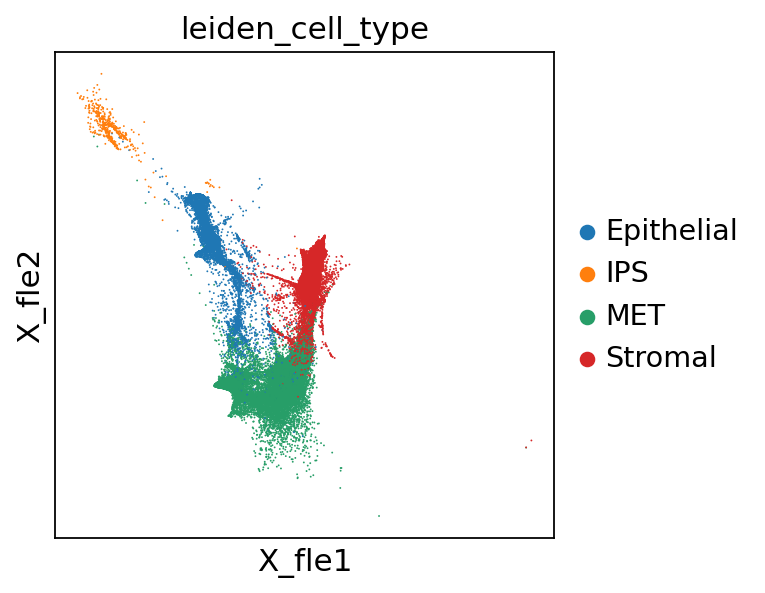

In [9]:
sc.pl.embedding(ad_sc, basis='X_fle', color=['leiden_cell_type'], save='_leiden_cell_type.pdf')

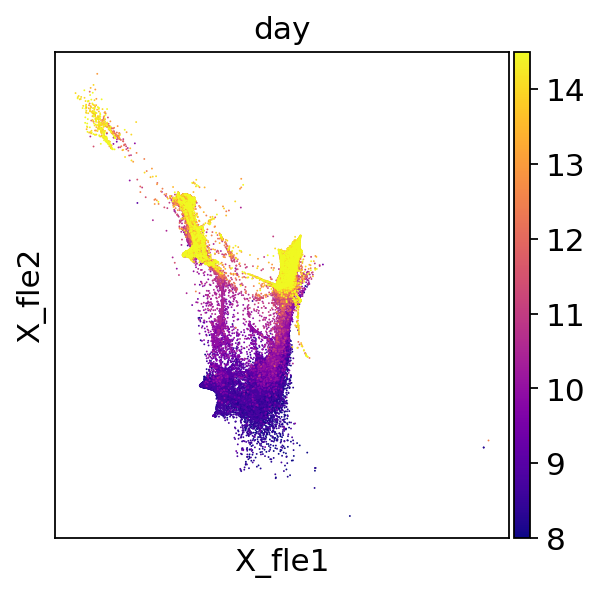

In [10]:
sc.pl.embedding(ad_sc, basis='X_fle', color='day', save='_days.pdf', color_map='plasma', )

### FLE

In [23]:
'''Unsupervised UMAP of all ~20K Raman points'''
# fn = '/home/kkobayas/koseki-data/Raman/data/full-map/full_map_10x_hcr_11_6_pp_all.h5ad'
fn = '/home/kkobayas/koseki-data/Raman/data/full-map/full_map_10x_hcr_11_6_pp_all_fle.h5ad'
ad_raman_all = pg.read_input(fn)
ad_raman_all

2021-10-04 19:46:25,183 - pegasusio.readwrite - INFO - h5ad file '/home/kkobayas/koseki-data/Raman/data/full-map/full_map_10x_hcr_11_6_pp_all.h5ad' is loaded.


INFO:pegasusio.readwrite:h5ad file '/home/kkobayas/koseki-data/Raman/data/full-map/full_map_10x_hcr_11_6_pp_all.h5ad' is loaded.


2021-10-04 19:46:25,185 - pegasusio.readwrite - INFO - Function 'read_input' finished in 1.89s.


INFO:pegasusio.readwrite:Function 'read_input' finished in 1.89s.


MultimodalData object with 1 UnimodalData: 'unknown-rna'
    It currently binds to UnimodalData object unknown-rna

UnimodalData object with n_obs x n_vars = 27639 x 930
    Genome: unknown; Modality: rna
    It contains 1 matrix: 'X'
    It currently binds to matrix 'X' as X

    obs: 'image', 'day', 'pos', 'pix_x', 'pix_y', 'gfp', 'Peg10', 'Utf1', 'Krt7', 'Epcam', 'Bgn', 'Nnat', 'Col1a1', 'Fabp1', 'Nanog'
    var: 
    obsm: 
    varm: 
    uns: 'genome', 'modality'

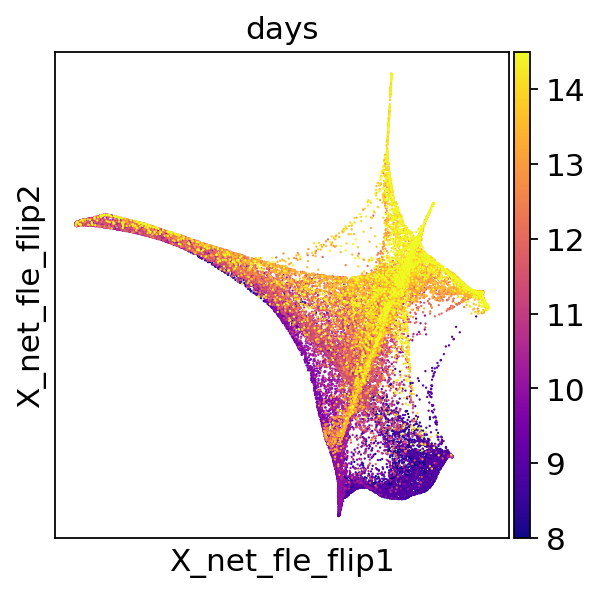

In [27]:
ad_raman_all.obs['days'] = [float(d[1:]) for d in ad_raman_all.obs.day]
ad_raman_all.obsm['X_net_fle_flip'] = ad_raman_all.obsm['X_net_fle']*(-1)
sc.pl.embedding(ad_raman_all.to_anndata(), basis='X_net_fle_flip', color='days', cmap='plasma', save='_raman_days.pdf')
# fig = pg.scatter(ad_raman_all,attrs='days', basis='net_fle_flip', cmaps='plasma', dpi=80, return_fig=True)
# # sc.pl.embedding(ad_raman_all, basis='X_fle', color='days', cmap='plasma', save='_raman_days.pdf')
# fig.savefig('figures/X_net_fle_raman_days.pdf')

***
# Predict scRNAseq from Raman

## Predict HCR genes from Raman

In [9]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, f1_score, mean_squared_error, r2_score
import catboost
from catboost import CatBoostRegressor, Pool, cv
from sklearn.decomposition import PCA
from scipy.stats import pearsonr

In [10]:
'visualize test/train results''PCA preprocessing'''
pca = PCA(n_components=50)
pcs = pca.fit_transform(ad_sp_raman.X)

X_trn, X_tst, Y_trn, Y_tst = train_test_split(pcs, ad_sp_raman.obs, test_size=0.5)
# X_trn, X_tst, Y_trn, Y_tst = train_test_split(pcs, ad_sp_raman.obs, test_size=0.1)

In [11]:
'''Let's do some deep learning'''
# ok build a net that ll do the regress

# get the cuda
device = torch.device("cuda")

raman_regression = nn.Sequential(
    nn.Linear(X_trn.shape[1], 512),
    nn.BatchNorm1d(512),
    nn.ReLU(),
    nn.Linear(512, 128),
    nn.BatchNorm1d(128),
    nn.ReLU(),
    nn.Linear(128, Y_trn.shape[1]),
    nn.ReLU(),
)

# opt
raman_opt = optim.Adam(
    raman_regression.parameters(), lr=1e-5,
)

# loss
# F.mse_loss(
#     recon_x, x,
# ) * 1e5

batch_size = 1<<6

raman_train_data_loader = DataLoader(
    TensorDataset(
        torch.from_numpy(X_trn),
        torch.from_numpy(Y_trn),
    ), batch_size=batch_size,
    shuffle=True, num_workers=1, pin_memory=True,
)

raman_regression = raman_regression.to(device)

epochs = 70
# epochs = 100
# epochs = 50
# epochs = 100
for epoch in range(epochs):
    epoch_loss = 0.0
    for _id, ([this_batch, this_label]) in enumerate(raman_train_data_loader):
        this_batch = this_batch.to(device)
        this_label = this_label.to(device)
        raman_opt.zero_grad()
        predicted_labels = raman_regression(this_batch.float())
        this_batch_loss = F.mse_loss(
            predicted_labels.float(), this_label.float(),
        ) * 1e5

        this_batch_loss.backward()
        epoch_loss += this_batch_loss.item()
        raman_opt.step()

    print('====> Epoch: {} Average loss: {:.10f}'.format(
          epoch+1, epoch_loss / len(raman_train_data_loader.dataset)))



====> Epoch: 1 Average loss: 363.5534094226
====> Epoch: 2 Average loss: 264.7822901783
====> Epoch: 3 Average loss: 215.1560349066
====> Epoch: 4 Average loss: 182.5245345724
====> Epoch: 5 Average loss: 159.0598742280
====> Epoch: 6 Average loss: 144.8957344288
====> Epoch: 7 Average loss: 131.9453833176
====> Epoch: 8 Average loss: 121.2773565932
====> Epoch: 9 Average loss: 113.9641819057
====> Epoch: 10 Average loss: 105.6774891541
====> Epoch: 11 Average loss: 100.6401783691
====> Epoch: 12 Average loss: 94.7219577966
====> Epoch: 13 Average loss: 88.4899713897
====> Epoch: 14 Average loss: 83.3143154508
====> Epoch: 15 Average loss: 80.1558272550
====> Epoch: 16 Average loss: 74.6665729234
====> Epoch: 17 Average loss: 73.3531474336
====> Epoch: 18 Average loss: 68.9762968740
====> Epoch: 19 Average loss: 66.3288612628
====> Epoch: 20 Average loss: 63.6913857249
====> Epoch: 21 Average loss: 60.0929402789
====> Epoch: 22 Average loss: 56.2036545115
====> Epoch: 23 Average loss: 

In [12]:
raman_regression = raman_regression.to('cpu')
Y_tst_pred = raman_regression(
    torch.from_numpy(X_tst)
).detach().numpy()

Y_tst_pred

array([[0.41015497, 0.7511463 , 0.7144656 , 0.67735916],
       [0.3248484 , 0.7141502 , 0.513805  , 0.60678166],
       [0.32836533, 0.800586  , 0.6445791 , 0.68382084],
       ...,
       [0.16590992, 0.8131944 , 0.5713459 , 0.5028219 ],
       [0.28271788, 0.8771547 , 0.70695996, 0.63837874],
       [0.26024085, 0.81919175, 0.64044863, 0.6387392 ]], dtype=float32)

In [13]:
raman_regression = raman_regression.to('cpu')
Y_trn_pred = raman_regression(
    torch.from_numpy(X_trn)
).detach().numpy()

Y_trn_pred

array([[0.3416882 , 0.7465521 , 0.5803589 , 0.58268046],
       [0.3428524 , 0.8572126 , 0.65722543, 0.6376629 ],
       [0.22009833, 0.7778258 , 0.577303  , 0.5700651 ],
       ...,
       [0.3277363 , 0.8451845 , 0.7041245 , 0.64614445],
       [0.28622952, 0.8137251 , 0.6148601 , 0.6325333 ],
       [0.27834058, 0.7420447 , 0.61485547, 0.6744236 ]], dtype=float32)

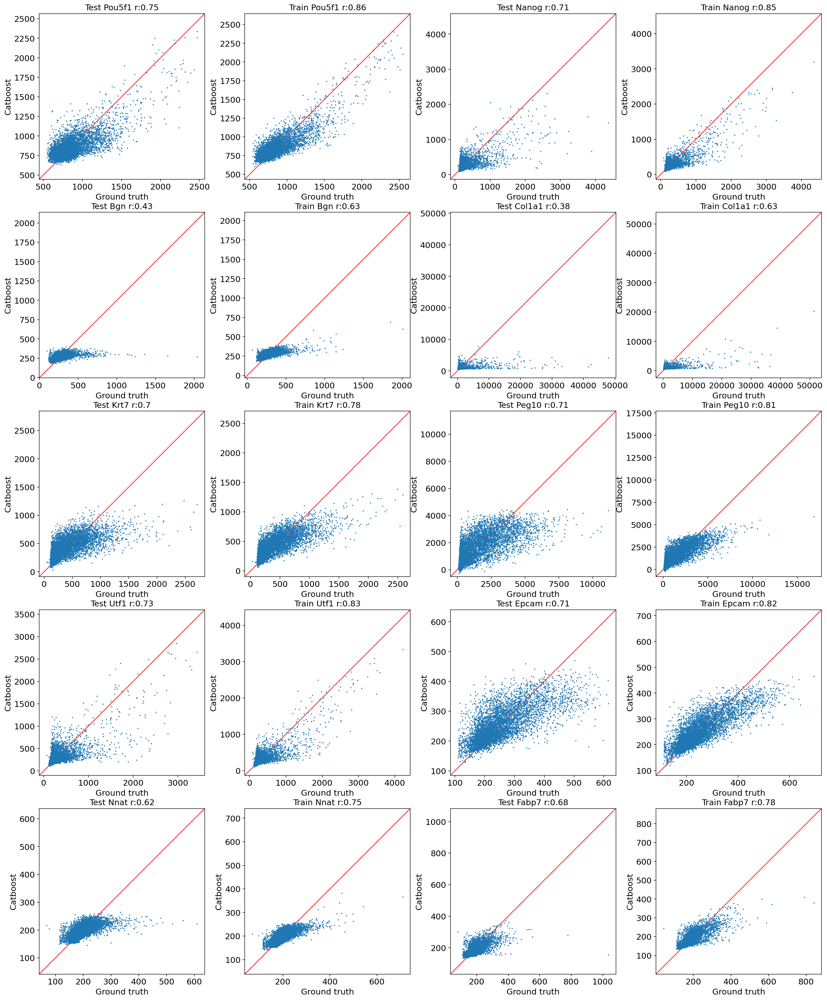

In [12]:
'''Vizualize prediction of each gene'''
fig, axs = plt.subplots(5,4,figsize=(24,30))

# test prediction
ggenes = np.repeat(genes, 2)
y_tr_pred_boost = dict()
for i,ax in zip(range(len(ggenes)), axs.flatten()):
    if (i%2==0):
        r = round(pearsonr(Y_tst[ggenes[i]], y_pred_boost[ggenes[i]])[0], 2)
        ax.scatter(Y_tst[ggenes[i]], y_pred_boost[ggenes[i]], s=1)
        ax.set_title('Test '+ggenes[i]+' r:'+str(r))
    else:
        y_tr_pred_boost[ggenes[i]] = model[ggenes[i]].predict(X_trn)
        r = round(pearsonr(Y_trn[ggenes[i]], y_tr_pred_boost[ggenes[i]])[0], 2)
        ax.scatter(Y_trn[ggenes[i]], y_tr_pred_boost[ggenes[i]], s=1)
        ax.set_title('Train '+ggenes[i]+' r:'+str(r))
    ax.set_xlabel('Ground truth')
    ax.set_ylabel('Catboost')

    lims = [
        np.min([ax.get_xlim(), ax.get_ylim()]),  # min of both axes
        np.max([ax.get_xlim(), ax.get_ylim()]),  # max of both axes
    ]
    # now plot both limits against eachother
    ax.plot(lims, lims, 'r-', alpha=0.75, zorder=0)
    ax.set_aspect('equal')
    ax.set_xlim(lims)
    ax.set_ylim(lims)
    ax.grid(None)
# fig.savefig('hcr_catboost_regression.pdf')

In [13]:
'''format test prediction results in to anndata'''
X = np.zeros((Y_tst.shape[0], len(genes)))

for i,key in enumerate(y_pred_boost.keys()):
    X[:, i] = y_pred_boost[key]
    
ad_sp_pred = sc.AnnData(X=X)
ad_sp_pred.obs_names = Y_tst.index
ad_sp_pred.var_names = y_pred_boost.keys()
mask = ad_sp_pred.var_names == 'Pou5f1'
ad_sp_pred = ad_sp_pred[:,~mask]
ad_sp_pred

View of AnnData object with n_obs × n_vars = 6392 × 9

In [14]:
'''format train prediction results in to anndata'''
X = np.zeros((Y_trn.shape[0], len(genes)))

for i,key in enumerate(y_tr_pred_boost.keys()):
    X[:, i] = y_tr_pred_boost[key]
    
ad_sp_tr_pred = sc.AnnData(X=X)
ad_sp_tr_pred.obs_names = Y_trn.index
ad_sp_tr_pred.var_names = y_tr_pred_boost.keys()
mask = ad_sp_tr_pred.var_names == 'Pou5f1'
ad_sp_tr_pred = ad_sp_tr_pred[:,~mask]
ad_sp_tr_pred

View of AnnData object with n_obs × n_vars = 6391 × 9

## Predict scRNAseq from HCR

In [15]:
'''predict scrnaseq from raman'''
ad_sc_bal_pp, ad_sp_pred_pp = tg.pp_adatas(ad_sc_bal, ad_sp_pred)
# ad_sc_bal_pp, ad_sp= tg.pp_adatas(ad_sc, ad_sp_pred)
ad_sc_bal_pp

np.random.seed(2021)
ad_map = tg.map_cells_to_space(
    adata_cells=ad_sc_bal_pp,
    adata_space=ad_sp_pred_pp,
#     device='cpu',
    device='cuda:0',
    random_state=2021
)
ad_tr = tg.project_genes(ad_map, ad_sc_bal)#, cluster_label='leiden_cell_type')
# ad_tr = tg.project_genes(ad_map, ad_sc)#, cluster_label='leiden_cell_type')
ad_tr

INFO:root:9 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 9 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.911
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000


INFO:root:Saving results..


AnnData object with n_obs × n_vars = 6392 × 17737
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'n_cells', 'is_training'

In [16]:
'''conduct label transfer on ground truth HCR'''
ad_sp_hcr_sub = ad_sp_hcr[ad_sp_pred.obs_names,:]
ad_sc_bal_label_pp, ad_sp_hcr_sub_pp= tg.pp_adatas(ad_sc_bal, ad_sp_hcr_sub)
# ad_sc_bal_label_pp, ad_sp_hcr_sub_pp= tg.pp_adatas(ad_sc, ad_sp_hcr_sub)
np.random.seed(2021)
ad_map_label = tg.map_cells_to_space(
    adata_cells=ad_sc_bal_label_pp,
    adata_space=ad_sp_hcr_sub_pp,
#     device='cpu',
    device='cuda:0',
    random_state=2021
)
annos = tg.project_cell_annotations(ad_map_label, annotation='leiden_cell_type')

INFO:root:9 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 9 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.783
Score: 0.995
Score: 0.996
Score: 0.996
Score: 0.996
Score: 0.996
Score: 0.996
Score: 0.996
Score: 0.997
Score: 0.997


INFO:root:Saving results..


In [17]:
'''conduct label transfer on predicted rnaseq'''
np.random.seed(2021)
ad_map_pred = tg.map_cells_to_space(
    adata_cells=ad_sc_bal_pp,
    adata_space=ad_sp_pred_pp,
#     device='cpu',
    device='cuda:0',
    random_state=2021
)
annos_pred = tg.project_cell_annotations(ad_map_pred, annotation='leiden_cell_type')
annos_pred

INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 9 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.911
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000


INFO:root:Saving results..


,Epithelial,IPS,MET,Stromal
0,0.042399,0.069532,0.095205,0.069715
1,0.063248,0.121744,0.070816,0.063899
2,0.116765,0.053526,0.049545,0.072357
3,0.044462,0.163318,0.123973,0.065001
4,0.057255,0.042249,0.092169,0.063963
...,...,...,...,...
6387,0.035033,0.037279,0.063296,0.058763
6388,0.078208,0.057904,0.067954,0.075959
6389,0.064234,0.083972,0.094608,0.158874
6390,0.085598,0.214909,0.073123,0.065529


In [18]:
annos.index = ad_tr.obs.index
annos_pred.index = ad_tr.obs.index
ad_tr.obs[annos.columns] = annos
ad_tr.obs['predicted_id'] = annos.idxmax(axis=1)
ad_tr.obs['predicted_id_pred'] = annos_pred.idxmax(axis=1)
ad_sp_hcr_sub.obs['predicted_id'] = annos.idxmax(axis=1)
ad_sp_hcr_sub.obs['predicted_id_pred'] = annos_pred.idxmax(axis=1)
ad_tr.obs.head(2)

,Epithelial,IPS,MET,Stromal,predicted_id,predicted_id_pred
3628,0.044664,0.049910,0.147800,0.019123,MET,MET
19629,0.052689,0.200362,0.062969,0.109873,IPS,IPS


## Visualize by scatter plot 

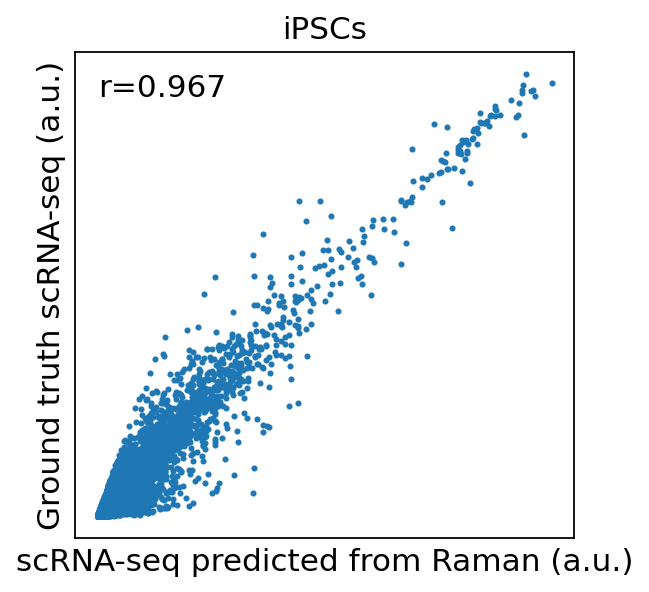

In [20]:
ct = ['IPS', 'Epithelial', 'Stromal', 'MET'][0]

mask = ad_tr.obs.predicted_id == ct
X_hcr = np.mean(ad_tr[mask].X, axis=0)

mask = ad_sc_bal.obs.leiden_cell_type == ct
X_rna = np.mean(np.array(ad_sc_bal[mask].X.todense()), axis=0)

plt.grid(None)
plt.scatter(X_hcr, X_rna, s=3)
plt.text(0, 4, 'r='+str(round(pearsonr(X_hcr, X_rna)[0], 3)))
plt.xticks([])
plt.yticks([])
plt.title('iPSCs')
plt.xlabel('scRNA-seq predicted from Raman (a.u.)')
plt.ylabel('Ground truth scRNA-seq (a.u.)')
plt.savefig('figures/'+ct+'_raman_scrnaseq_scatter.pdf')

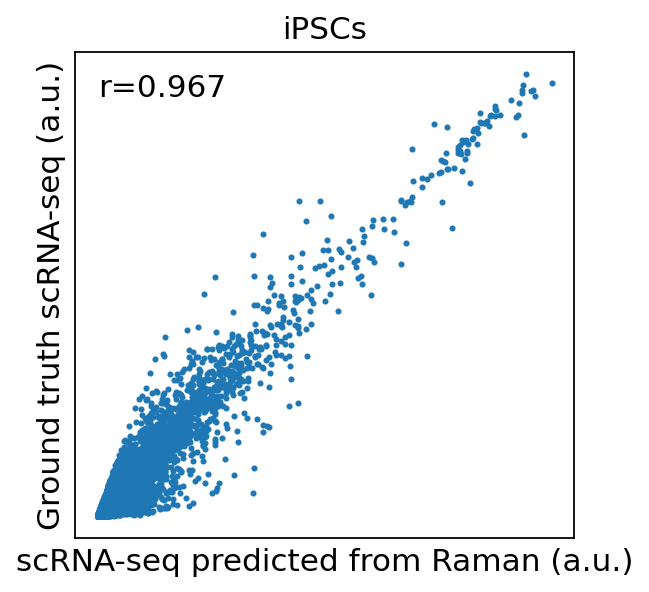

In [21]:
ct = ['IPS', 'Epithelial', 'Stromal', 'MET'][0]

mask = ad_tr.obs.predicted_id == ct
X_hcr = np.mean(ad_tr[mask].X, axis=0)

mask = ad_sc_bal.obs.leiden_cell_type == ct
X_rna = np.mean(np.array(ad_sc_bal[mask].X.todense()), axis=0)

plt.grid(None)
plt.scatter(X_hcr, X_rna, s=3)
plt.text(0, 4, 'r='+str(round(pearsonr(X_hcr, X_rna)[0], 3)))
plt.xticks([])
plt.yticks([])
plt.title('iPSCs')
plt.xlabel('scRNA-seq predicted from Raman (a.u.)')
plt.ylabel('Ground truth scRNA-seq (a.u.)')
plt.savefig('figures/'+ct+'_raman_scrnaseq_scatter.pdf')

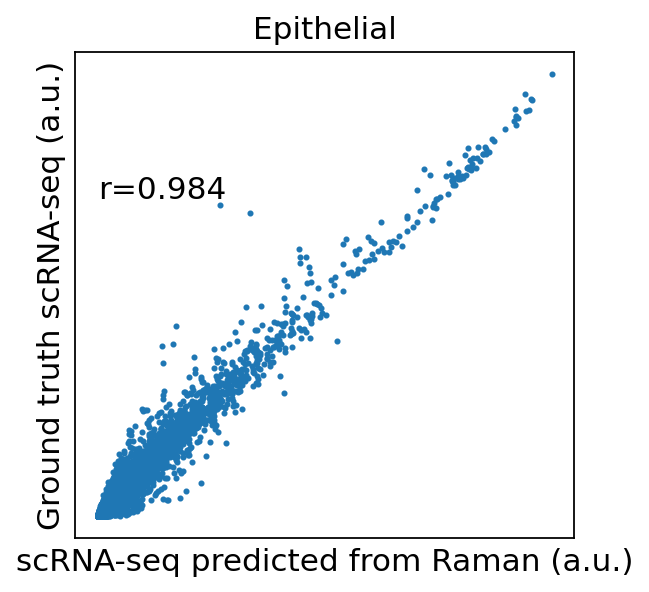

In [22]:
ct = ['IPS', 'Epithelial', 'Stromal', 'MET'][1]

mask = ad_tr.obs.predicted_id == ct
X_hcr = np.mean(ad_tr[mask].X, axis=0)

mask = ad_sc_bal.obs.leiden_cell_type == ct
X_rna = np.mean(np.array(ad_sc_bal[mask].X.todense()), axis=0)

plt.grid(None)
plt.scatter(X_hcr, X_rna, s=3)
plt.text(0, 3, 'r='+str(round(pearsonr(X_hcr, X_rna)[0], 3)))
plt.xticks([])
plt.yticks([])
plt.title(ct)
plt.xlabel('scRNA-seq predicted from Raman (a.u.)')
plt.ylabel('Ground truth scRNA-seq (a.u.)')
plt.savefig('figures/'+ct+'_raman_scrnaseq_scatter.pdf')

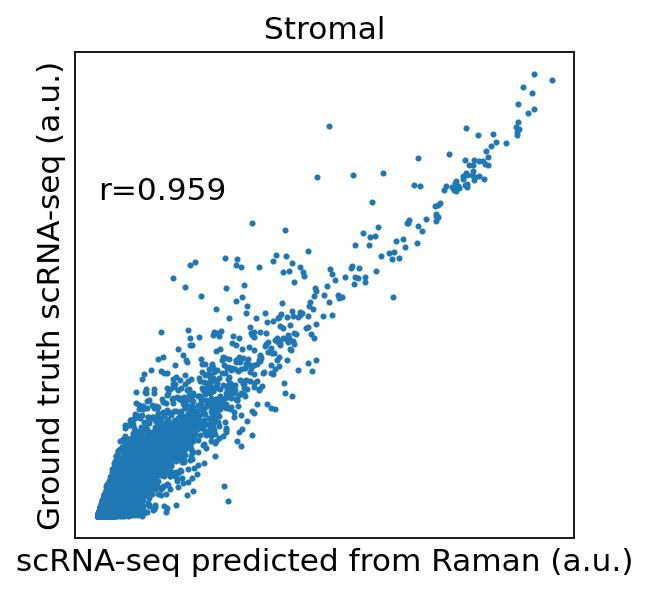

In [23]:
ct = ['IPS', 'Epithelial', 'Stromal', 'MET'][2]

mask = ad_tr.obs.predicted_id == ct
X_hcr = np.mean(ad_tr[mask].X, axis=0)

mask = ad_sc_bal.obs.leiden_cell_type == ct
X_rna = np.mean(np.array(ad_sc_bal[mask].X.todense()), axis=0)

plt.grid(None)
plt.scatter(X_hcr, X_rna, s=3)
plt.text(0, 3, 'r='+str(round(pearsonr(X_hcr, X_rna)[0], 3)))
plt.xticks([])
plt.yticks([])
plt.title(ct)
plt.xlabel('scRNA-seq predicted from Raman (a.u.)')
plt.ylabel('Ground truth scRNA-seq (a.u.)')
plt.savefig('figures/'+ct+'_raman_scrnaseq_scatter.pdf')

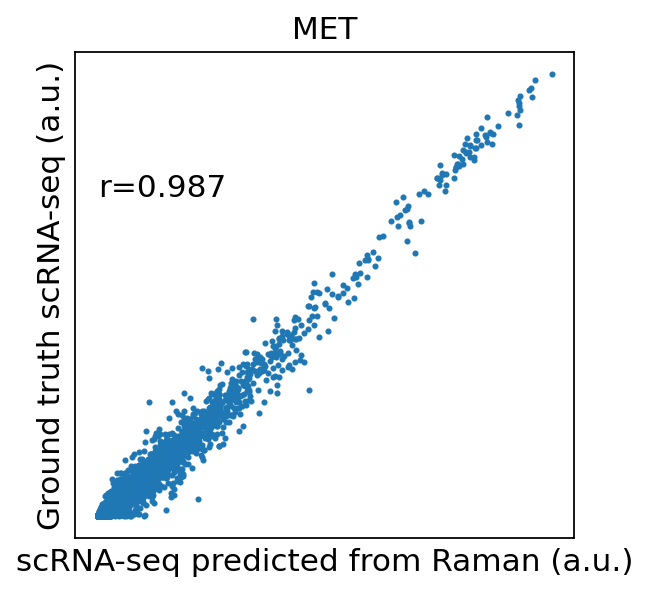

In [24]:
ct = ['IPS', 'Epithelial', 'Stromal', 'MET'][3]

mask = ad_tr.obs.predicted_id == ct
X_hcr = np.mean(ad_tr[mask].X, axis=0)

mask = ad_sc_bal.obs.leiden_cell_type == ct
X_rna = np.mean(np.array(ad_sc_bal[mask].X.todense()), axis=0)

plt.grid(None)
plt.scatter(X_hcr, X_rna, s=3)
plt.text(0, 4, 'r='+str(round(pearsonr(X_hcr, X_rna)[0], 3)))
plt.xticks([])
plt.yticks([])
plt.title(ct)
plt.xlabel('scRNA-seq predicted from Raman (a.u.)')
plt.ylabel('Ground truth scRNA-seq (a.u.)')
plt.savefig('figures/'+ct+'_raman_scrnaseq_scatter.pdf')

## Visualize by pairwise heatmap

In [25]:
X_hcr = np.zeros((4, ad_tr.X.shape[1]))
X_rna = np.zeros((4, ad_sc_bal.X.shape[1])) 

celltypes = np.unique(ad_sc_bal.obs.leiden_cell_type)
for i,ct in enumerate(celltypes):
    mask = ad_tr.obs.predicted_id == ct
    X_hcr[i,:] = np.mean(ad_tr[mask].X, axis=0)
    mask = ad_sc_bal.obs.leiden_cell_type == ct
    X_rna[i,:] = np.mean(ad_sc_bal[mask].X, axis=0)
X_all = np.concatenate((X_hcr, X_rna))

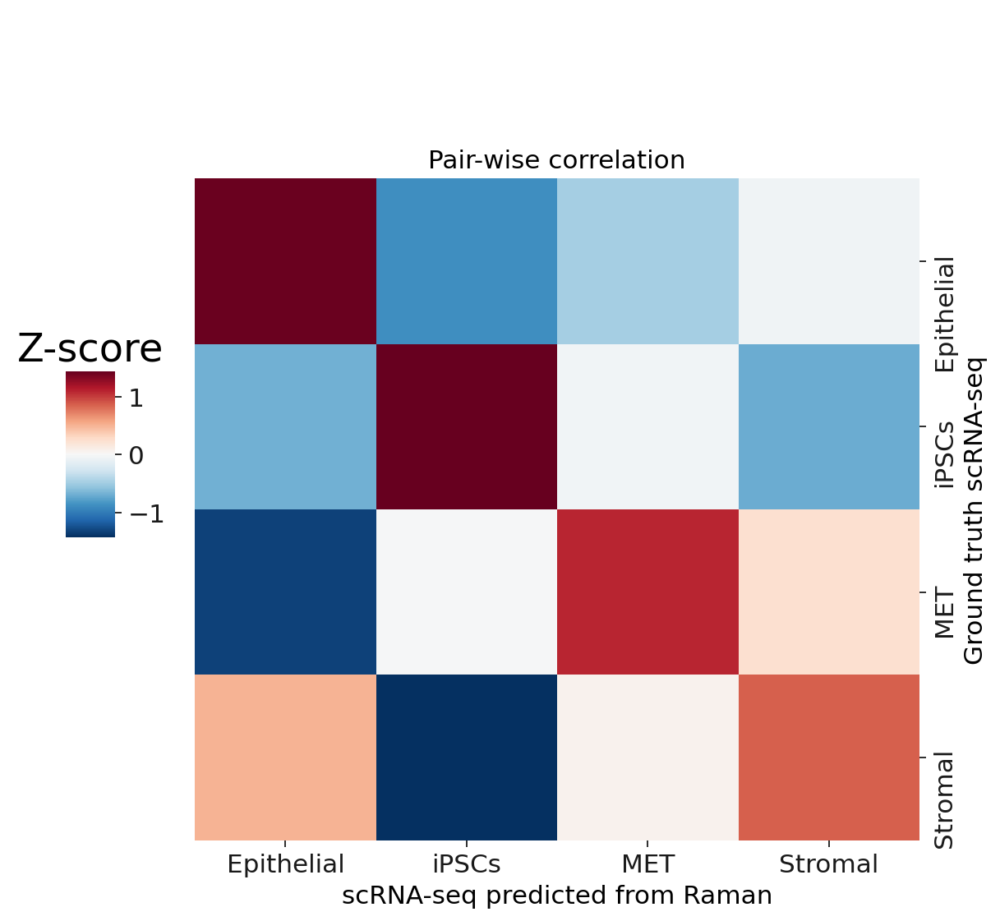

In [26]:
import seaborn as sns
# calculate the correlation matrix
# celltypes_hcr = ['Raman_'+ct for ct in celltypes]
celltypes_hcr = [' '+ct for ct in celltypes]

corr = pd.DataFrame(X_all.T, columns=np.append(celltypes_hcr, celltypes)).corr()

# plot the correlation heatmap
corr_sub = corr.loc[celltypes, celltypes_hcr]
g = sns.clustermap(corr_sub, z_score=0, cmap='RdBu_r', row_cluster=False, col_cluster=False, cbar_pos=(0.08, 0.4, 0.05, 0.18), figsize=(7.6,7))
g.ax_heatmap.set_title('Pair-wise correlation')
g.ax_heatmap.set(xlabel='scRNA-seq predicted from Raman', ylabel='Ground truth scRNA-seq')

ct_names = ['iPSCs' if ct=='IPS' else ct for ct in celltypes]
g.ax_heatmap.set_xticklabels(ct_names)
g.ax_heatmap.set_yticklabels(ct_names)
sns.set(font_scale=1.8)
plt.title('Z-score')
plt.savefig('figures/correlation_matrix.pdf')

## Check if Tangram predicts high Nanog/Utf1 when it classifies as IPS

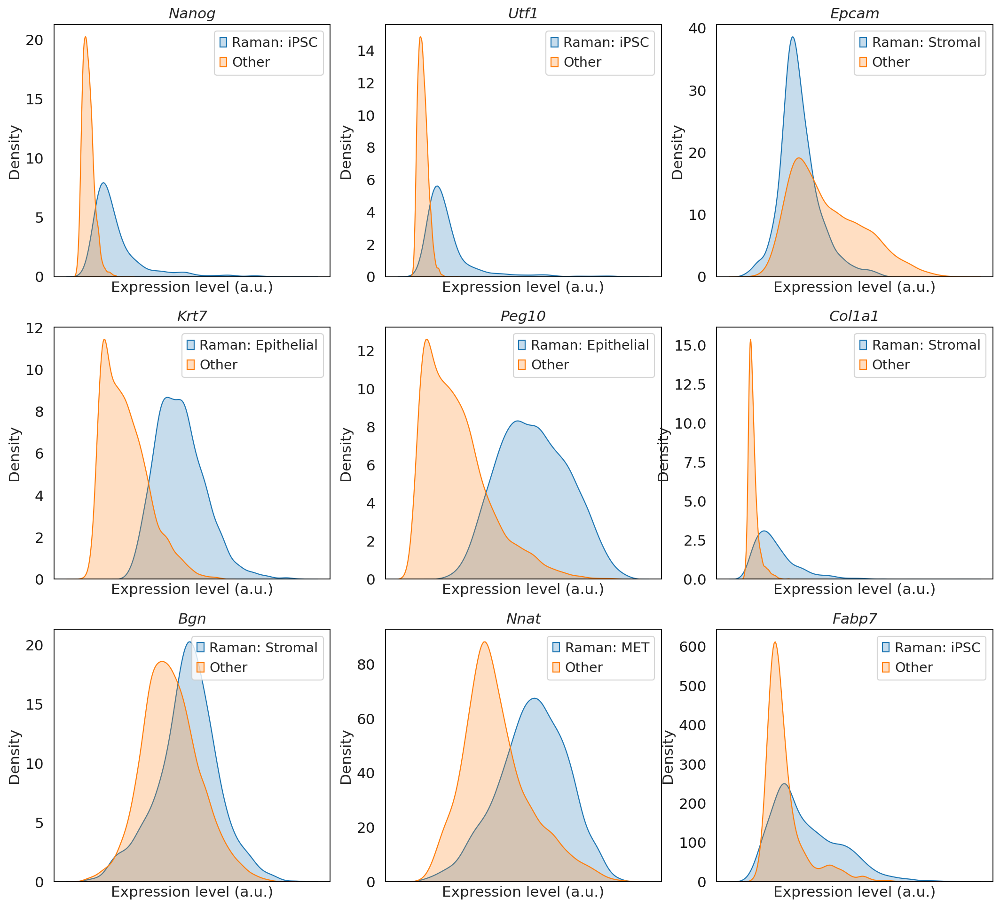

In [33]:
sc.settings.set_figure_params(dpi=80, facecolor='white')
genes = ['nanog', 'utf1', 'epcam', 'krt7', 'peg10', 'col1a1', 'bgn', 'nnat', 'fabp7']
cts = ['IPS', 'IPS', 'Stromal', 'Epithelial', 'Epithelial', 'Stromal', 'Stromal', 'MET', 'MET']
ct2 = ['iPSC', 'iPSC', 'Stromal', 'Epithelial', 'Epithelial', 'Stromal', 'Stromal', 'MET', 'iPSC']

fig, axs = plt.subplots(3,3, figsize=(16,15))
for i,ax in enumerate(axs.flatten()):
    g = genes[i]
    ct = cts[i]
    mask = ad_tr.obs['predicted_id_pred'] == ct
    ad_ct = ad_tr[mask]
    ad_else = ad_tr[~mask]

    sns.distplot(np.array(ad_ct[:,g].X), hist=False, ax=ax, kde_kws = {'shade': True})
    sns.distplot(np.array(ad_else[:,g].X), hist=False, ax=ax, kde_kws = {'shade': True})
    ax.grid(None)
    ax.legend(['Raman: '+ct2[i], 'Other'])
    ax.set_title(g.capitalize(), style='italic')
    ax.set_xlabel('Expression level (a.u.)')
    ax.set_xticks([])
plt.savefig('figures/density_plot_9genes_R2R.pdf')

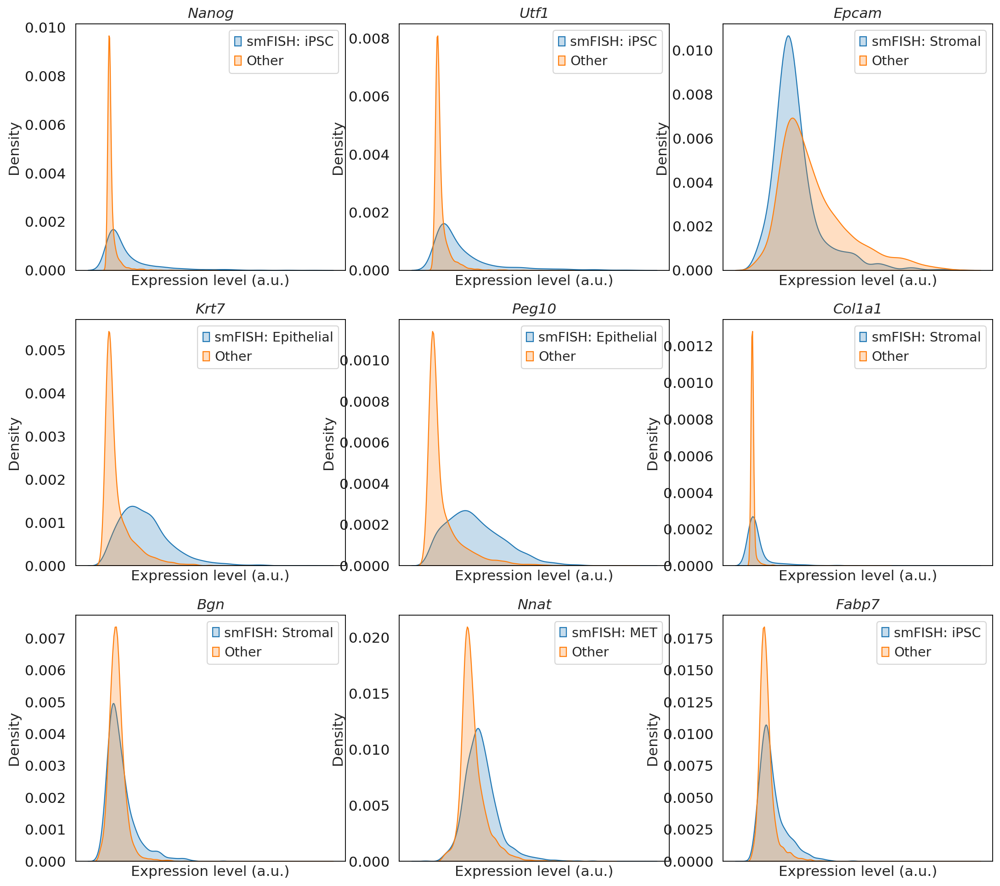

In [35]:
sc.settings.set_figure_params(dpi=80, facecolor='white')
genes = ['Nanog', 'Utf1', 'Epcam', 'Krt7', 'Peg10', 'Col1a1', 'Bgn', 'Nnat', 'Fabp7']
cts = ['IPS', 'IPS', 'Stromal', 'Epithelial', 'Epithelial', 'Stromal', 'Stromal', 'MET', 'MET']
ct2 = ['iPSC', 'iPSC', 'Stromal', 'Epithelial', 'Epithelial', 'Stromal', 'Stromal', 'MET', 'iPSC']

fig, axs = plt.subplots(3,3, figsize=(16,15))
for i,ax in enumerate(axs.flatten()):
    g = genes[i]
    ct = cts[i]
#     mask = ad_sp_hcr_sub.obs['predicted_id_pred'] == ct
    mask = ad_tr.obs['predicted_id_pred'] == ct
#     mask = ad_tr.obs['predicted_id'] == ct
    ad_ct = ad_sp_hcr_sub[mask]
    ad_else = ad_sp_hcr_sub[~mask]

    sns.distplot(np.array(ad_ct[:,g].X), hist=False, ax=ax, kde_kws = {'shade': True})
    sns.distplot(np.array(ad_else[:,g].X), hist=False, ax=ax, kde_kws = {'shade': True})
    ax.grid(None)
    ax.legend(['smFISH: '+ct2[i], 'Other'])
    ax.set_title(g.capitalize(), style='italic')
    ax.set_xlabel('Expression level (a.u.)')
    ax.set_xticks([])
plt.savefig('figures/density_plot_9genes_smFISH.pdf')

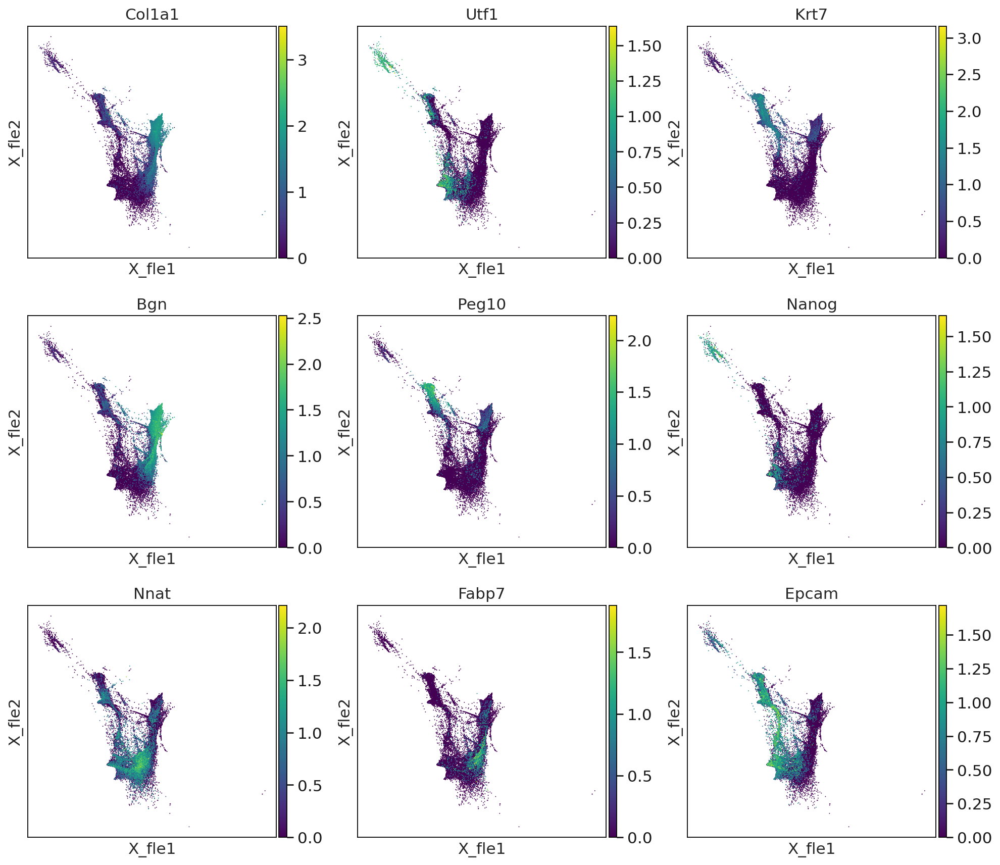

In [29]:
sc.pp.log1p(ad_sc)
sc.pl.embedding(ad_sc, basis='X_fle', color=[g.capitalize() for g in ad_sc_bal_pp.var_names], ncols=3, save='_markergenes.pdf', color_map='viridis')
# sc.pl.embedding(ad_sc, basis='X_fle', gene_symbols=[g.capitalize() for g in ad_sc.var_names], color=ad_sc_bal_pp.var_names, ncols=3, save='_markergenes.pdf')

***
# Integrate predicted scRNAseq to reference non-balanced scRNAseq UMAP

In [20]:
ad_tr_pp, ad_sc_pp = tg.pp_adatas(ad_tr, ad_sc)
sc.pp.log1p(ad_tr_pp)
sc.pp.log1p(ad_sc_pp)
# sc.pp.highly_variable_genes(ad_sc_pp)
# ad_tr_pp, ad_sc_pp = tg.pp_adatas(ad_tr, ad_sc)

filtered out 128 genes that are detected in less than 1 cells


INFO:root:17737 marker genes shared by AnnDatas.


In [24]:
# sc.pp.subsample(ad_sc_pp, fraction=0.15)
sc.pp.pca(ad_sc_pp)
sc.pp.neighbors(ad_sc_pp, metric='cosine')
sc.tl.umap(ad_sc_pp)

# ad_sc_pp.obs['predicted_id'] = ad_sc_pp.obs['leiden_cell_type']
sc.tl.ingest(ad_tr_pp, ad_sc_pp, embedding_method='umap', labeling_method='knn')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:10)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:15)
running ingest
    finished (0:00:22)


In [25]:
gs = ['nanog','utf1', 'krt7','peg10', 'col1a1','bgn','epcam','fabp7','nnat']

for g in gs:
    ad_sc_pp.obs['ref_'+g] = np.nan
    ad_tr_pp.obs['ref_'+g] = ad_tr_pp[:,g].X
    
    ad_sc_pp.obs['rna_'+g] = ad_sc_pp[:,g].X.toarray()
    ad_tr_pp.obs['rna_'+g] = np.nan
    
#     ad_tr_log.obs['batch'] = np.nan
ad_tr_pp.obs['batch'] = 'Raman scRNA-seq'
ad_tr_pp.obs['batch'] = ad_tr_pp.obs['batch'].astype('category') 
#     ad_sc_log.obs['batch'] = np.nan
ad_sc_pp.obs['batch'] = 'Ref scRNA-seq'
ad_sc_pp.obs['batch'] = ad_sc_pp.obs['batch'].astype('category')
# ad_sc_pp_sub = sc.pp.subsample(ad_sc_pp, fraction=0.5, copy=True)

ad_sc_pp.obs['raman_day'] = np.nan
ad_tr_pp.obs['raman_day'] = np.nan

# ad_sc_tr = sc.AnnData.concatenate(ad_sc_pp_sub, ad_tr_pp, join='inner')
ad_sc_tr = sc.AnnData.concatenate(ad_sc_pp, ad_tr_pp, join='inner')
df = ad_sc_tr.obs['batch']
df = df.replace(to_replace='0', value='Ref scRNA-seq')
df = df.replace(to_replace='1', value='Raman scRNA-seq')
ad_sc_tr.obs['batch']=df

ad_sc_tr.obs.head(2)

,cell_type,day,leiden,leiden_cell_type,ref_nanog,rna_nanog,ref_utf1,rna_utf1,ref_krt7,rna_krt7,...,ref_nnat,rna_nnat,batch,Epithelial,IPS,MET,Stromal,predicted_id,predicted_id_pred,raman_day
D9.5_serum_C1_TCAGGATCAATAGCAA-1-0,MET,9.50,0,MET,NaN,0.000000,NaN,0.000000,NaN,0.0,...,NaN,0.0,Ref scRNA-seq,NaN,NaN,NaN,NaN,NaN,NaN,NaN
D8.75_serum_C1_GAACATCCAGTCAGCC-1-0,MET,8.75,0,MET,NaN,0.646503,NaN,0.868003,NaN,0.0,...,NaN,0.0,Ref scRNA-seq,NaN,NaN,NaN,NaN,NaN,NaN,NaN


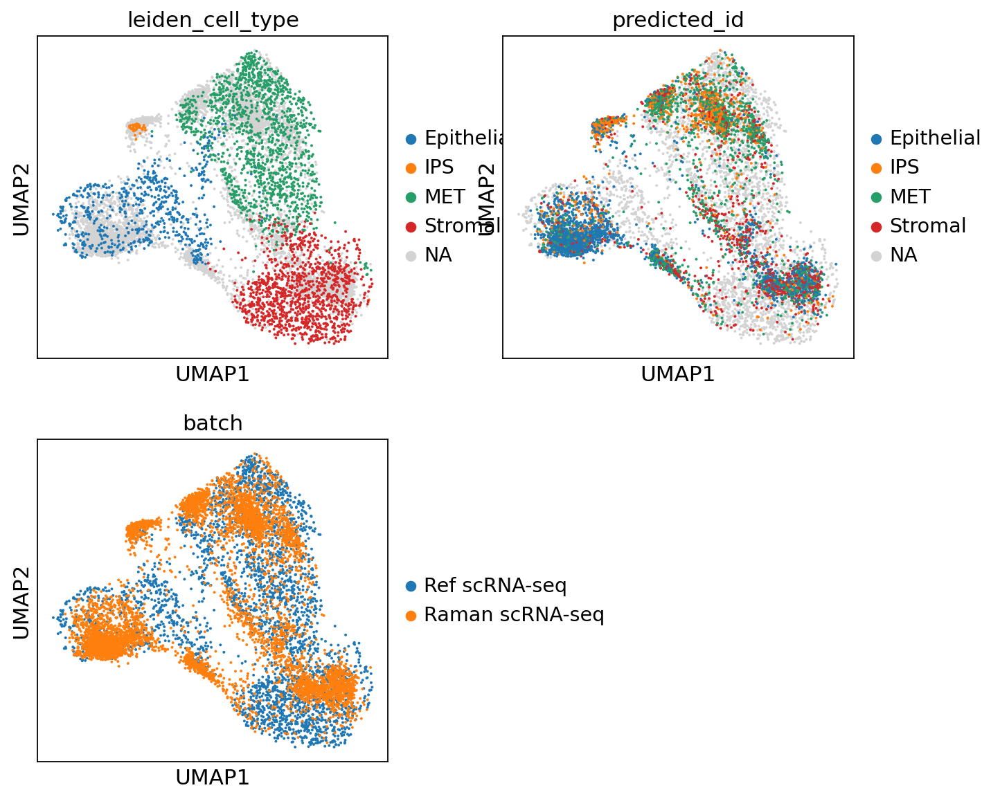

In [26]:
sc.pl.umap(ad_sc_tr, color=['leiden_cell_type', 'predicted_id', 'batch'], 
           ncols=2, save='_coembed_tangram_scrnaseq.pdf')
#            ncols=2, save='_coembed_tangram_scrnaseq_subsampled.pdf')
# sc.pl.umap(ad_sc_tr, color='leiden_cell_type', vmin='p1', vmax='p99', title='', save='_coembed_leiden.pdf')
# ax.legend(['Epithelial', 'iPSCs', 'MET', 'Stromal', 'Raman predicted'])
# plt.legend(['Epithelial', 'iPSCs', 'MET', 'Stromal', 'Raman predicted'])

## Day plot on UMAP

In [72]:
raman_obs = [o[:-2] for o in ad_sc_tr.obs_names if o[:-2] in ad_sp_raman.obs_names]

raman_day = ad_sp_raman[raman_obs, :].obs.day
raman_day = [float(d[1:]) for d in raman_day]

mask = ad_sc_tr.obs.batch=='Raman scRNA-seq'
ad_sc_tr.obs['raman_day'] = np.nan
ad_sc_tr.obs.loc[mask,'raman_day'] = raman_day
ad_sc_tr.obs['raman_day']

D13_serum_C1_CGTAGCGCATGCTGGC-1-0       NaN
D13_serum_C1_CGAGAAGGTAATCACC-1-0       NaN
D14.5_serum_C1_AGTGTCAAGGGCTTCC-1-0     NaN
D8.75_serum_C2_TCGGTAAAGAGTGACC-1-0     NaN
D8.25_serum_C2_AGAGCTTAGCGCTCCA-1-0     NaN
                                       ... 
4685-1                                  9.0
20723-1                                12.5
16858-1                                12.0
19489-1                                12.5
5244-1                                  9.0
Name: raman_day, Length: 31711, dtype: float64

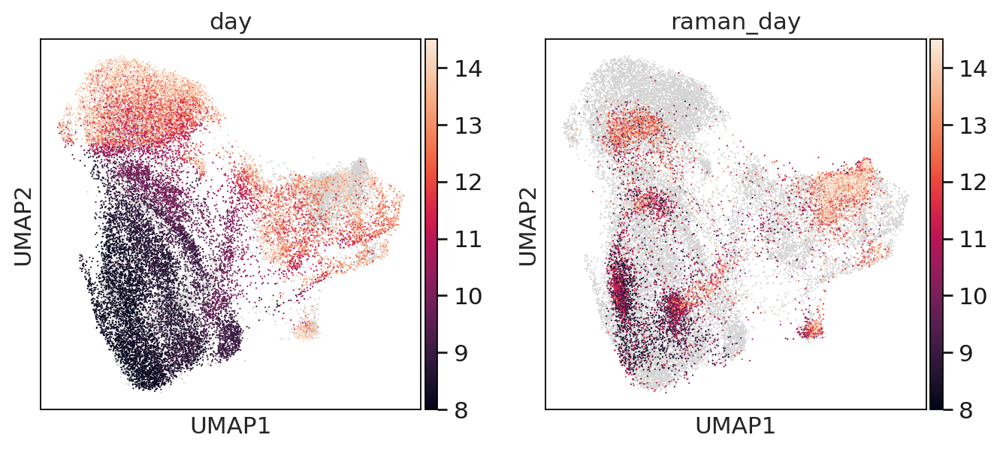

In [75]:
sc.pl.umap(ad_sc_tr, color=['day','raman_day'], save='_coembed_tangram_raman_days.pdf')
# sc.pl.umap(ad_sc_tr, color='leiden_cell_type', vmin='p1', vmax='p99', title='', save='_coembed_leiden.pdf')
# ax.legend(['Epithelial', 'iPSCs', 'MET', 'Stromal', 'Raman predicted'])
# plt.legend(['Epithelial', 'iPSCs', 'MET', 'Stromal', 'Raman predicted'])

## Density UMAP plot

In [27]:
sc.tl.embedding_density(ad_sc_tr, groupby='batch')

computing density on 'umap'
--> added
    'umap_density_batch', densities (adata.obs)
    'umap_density_batch_params', parameter (adata.uns)


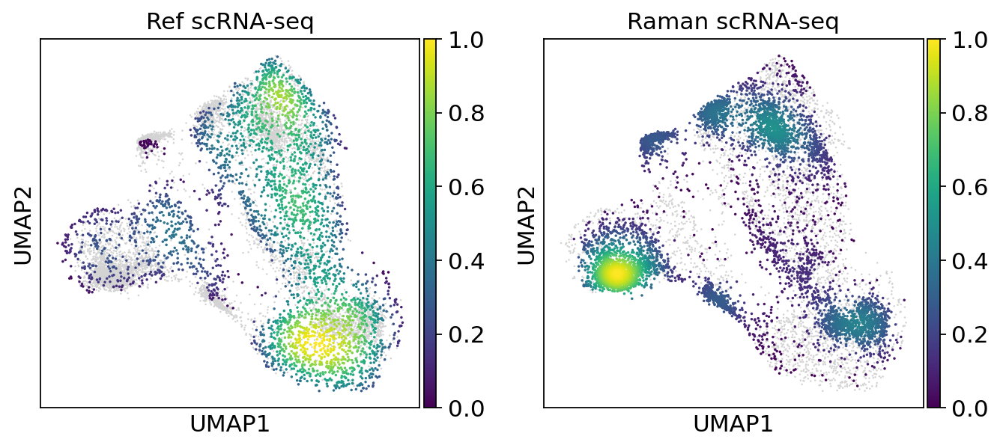

In [28]:
sc.pl.embedding_density(ad_sc_tr, basis='umap', key='umap_density_batch', bg_dotsize=5, fg_dotsize=10,
                       color_map='viridis', save='_coembed_density.pdf')
#                        color_map='viridis', save='_coembed_density_subsampled.pdf')

## UMAP gene scores

In [35]:
sc.pp.log1p(ad_sc_tr)
gs = ['nanog','utf1','krt7','peg10','bgn','col1a1','nnat','fabp7']
Gs = [g.capitalize() for g in gs]

ad_sc_tr_hcr = ad_sc_tr.copy()
indices = [idx+'-1' for idx in ad_sp_hcr_sub.obs_names]
ad_sc_tr_hcr[indices, gs].X = ad_sp_hcr_sub[:,Gs].X

sc.tl.score_genes(ad_sc_tr_hcr, ['nanog', 'utf1'], score_name='iPSCs_score')
sc.tl.score_genes(ad_sc_tr_hcr, ['krt7', 'peg10'], score_name='Epithelial_score')
sc.tl.score_genes(ad_sc_tr_hcr, ['bgn', 'col1a1'], score_name='Stromal_score')
sc.tl.score_genes(ad_sc_tr_hcr, ['nnat', 'fabp7'], score_name='MET_score')

for score in ['iPSCs_score', 'Epithelial_score', 'Stromal_score', 'MET_score']:
    ad_sc_tr_hcr.obs.loc[:,score+'_raman'] = ad_sc_tr_hcr.obs.loc[:,score]

mask = ad_sc_tr_hcr.obs.batch == 'Ref scRNA-seq'
ad_sc_tr_hcr.obs.loc[mask,'iPSCs_score_raman':'MET_score_raman'] = np.nan

mask = ad_sc_tr_hcr.obs.batch == 'Raman scRNA-seq'
ad_sc_tr_hcr.obs.loc[mask,'iPSCs_score':'MET_score'] = np.nan

computing score 'iPSCs_score'
    finished: added
    'iPSCs_score', score of gene set (adata.obs).
    50 total control genes are used. (0:00:04)
computing score 'Epithelial_score'
    finished: added
    'Epithelial_score', score of gene set (adata.obs).
    51 total control genes are used. (0:00:03)
computing score 'Stromal_score'
    finished: added
    'Stromal_score', score of gene set (adata.obs).
    51 total control genes are used. (0:00:02)
computing score 'MET_score'
    finished: added
    'MET_score', score of gene set (adata.obs).
    50 total control genes are used. (0:00:02)


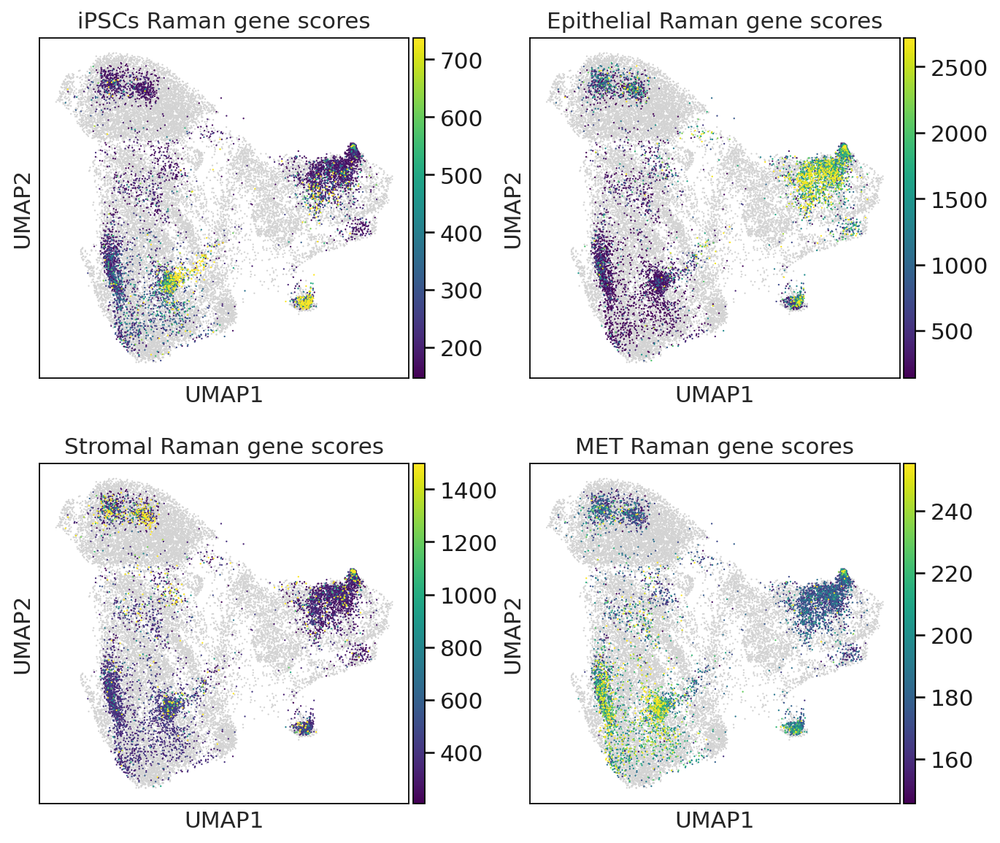

In [36]:
sc.pl.umap(ad_sc_tr_hcr, color=['iPSCs_score_raman', 'Epithelial_score_raman', 'Stromal_score_raman', 'MET_score_raman'], 
           vmin='p5', vmax='p95', save='_tangram_ramanscores.pdf', title=['iPSCs Raman gene scores', 'Epithelial Raman gene scores', 'Stromal Raman gene scores', 'MET Raman gene scores'], color_map='viridis',
           ncols=2
          )

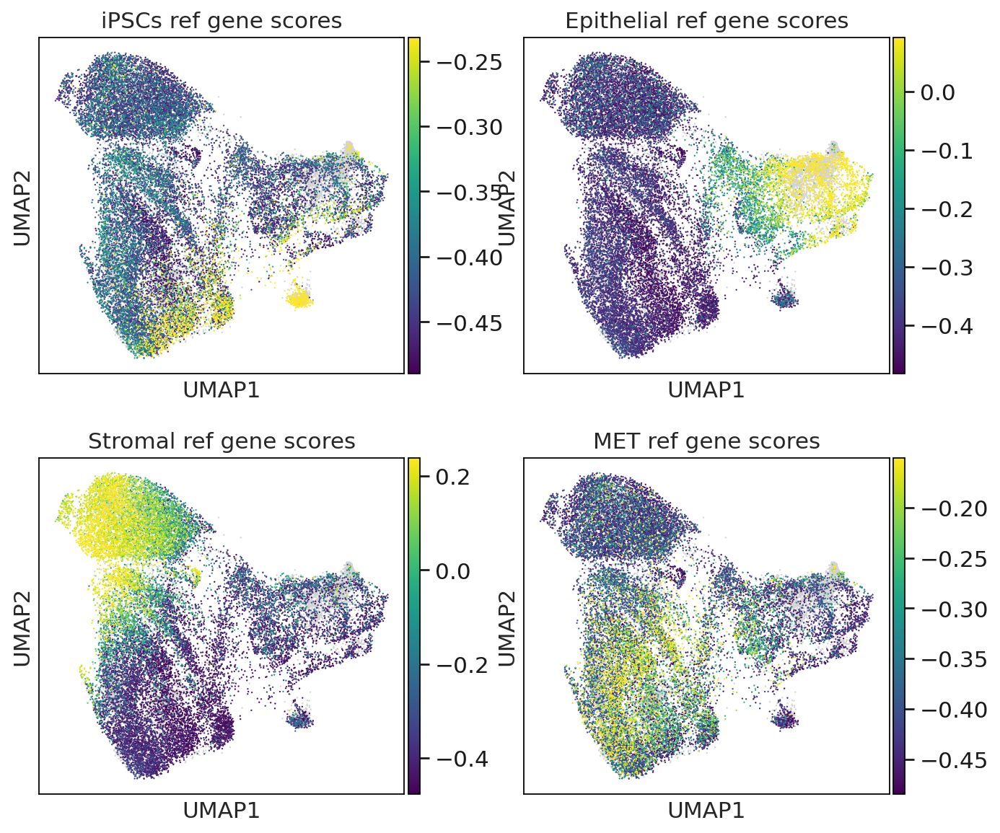

In [37]:
sc.pl.umap(ad_sc_tr_hcr, color=['iPSCs_score', 'Epithelial_score', 'Stromal_score', 'MET_score'], 
           vmin='p5', vmax='p95', save='_tangram_scores.pdf', title=['iPSCs ref gene scores', 'Epithelial ref gene scores', 'Stromal ref gene scores', 'MET ref gene scores'], color_map='viridis',
          ncols=2)

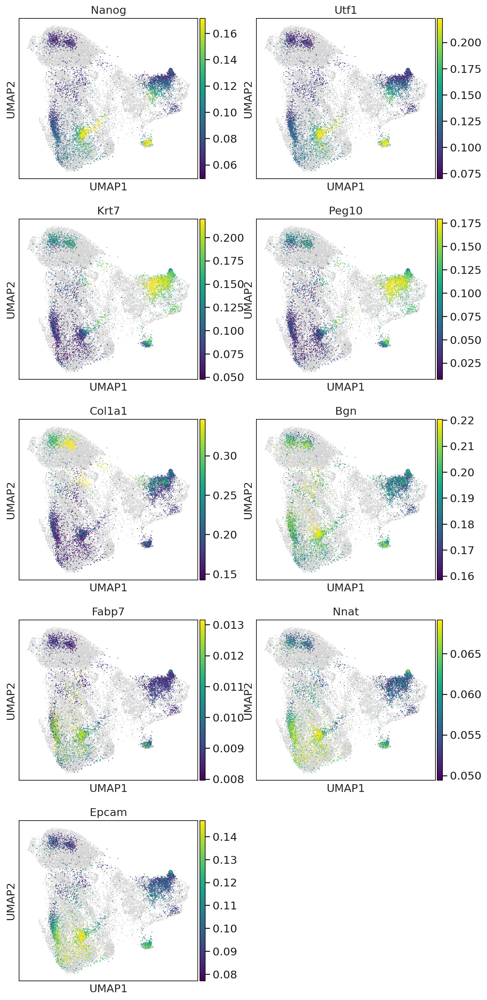

In [38]:
gs = ['nanog', 'utf1', 'krt7', 'peg10', 'col1a1', 'bgn', 'fabp7', 'nnat', 'epcam']
sc.pl.umap(ad_sc_tr_hcr, color=['ref_'+g for g in gs], vmin='p5', vmax='p95', save='_tangram_ramangenes.pdf', ncols=2,
          title=[g.capitalize() for g in gs], color_map='viridis')

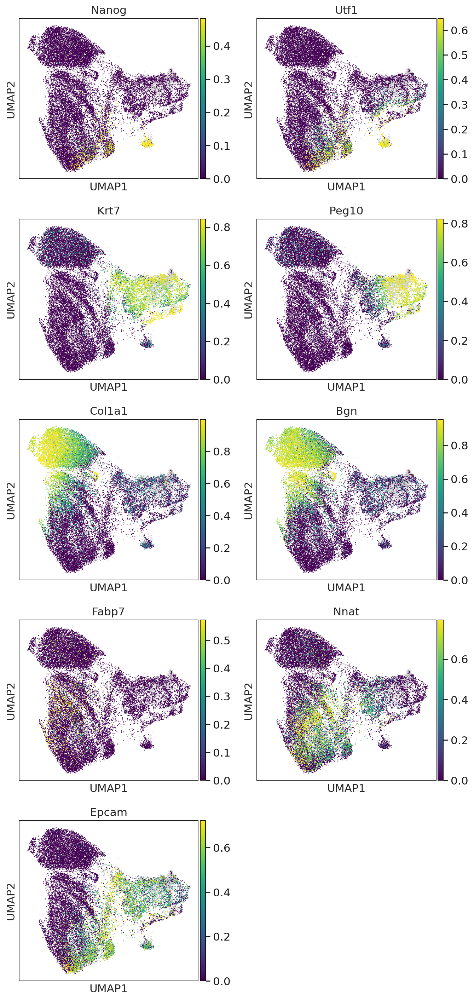

In [39]:
gs = ['nanog', 'utf1', 'krt7', 'peg10', 'col1a1', 'bgn', 'fabp7', 'nnat', 'epcam']
sc.pl.umap(ad_sc_tr_hcr, color=['rna_'+g for g in gs], vmin='p2', vmax='p98', save='_tangram_genes.pdf', ncols=2,
          title=[g.capitalize() for g in gs], color_map='viridis')

***
# Catboost feature importance score

In [40]:
xaxis = pd.read_csv('../x-axis_calibration/xaxis_wavenumber.csv', sep='\t', header=None)
xaxis = xaxis.iloc[:,410:].to_numpy().flatten()

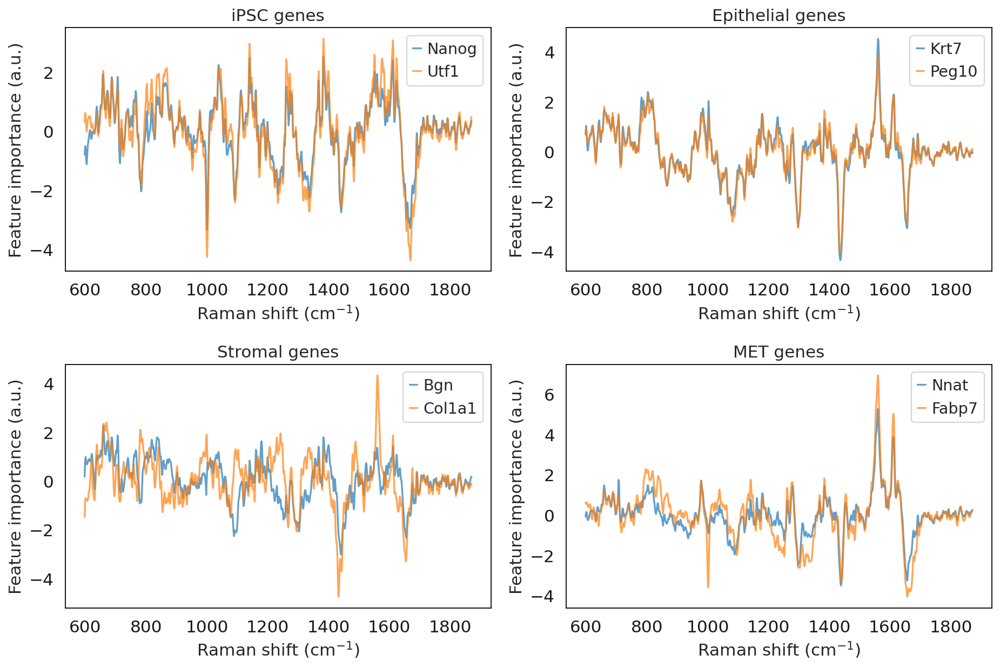

In [41]:
fig,axs = plt.subplots(2,2, figsize=(11.8,8))
# for g,ax in zip(model.keys(), axs.flatten()):
ct_gs = {'iPSC':['Nanog', 'Utf1'], 'Epithelial':['Krt7', 'Peg10'], 'Stromal':['Bgn', 'Col1a1'], 'MET':['Nnat', 'Fabp7']}
# fig.tight_layout()
for ct, ax in zip(ct_gs.keys(), axs.flatten()):
    for g in ct_gs[ct]:
        feature_scores = model[g].get_feature_importance()
        ax.plot(xaxis, np.dot(feature_scores, pca.components_), alpha=0.7)
    ax.legend(ct_gs[ct])
    ax.grid(None)
    ax.set_title(ct+' genes')
    ax.set_xlabel('Raman shift (cm$^{-1})$')
    ax.set_ylabel('Feature importance (a.u.)')
plt.tight_layout()
plt.savefig('figures/feature_importance_all_genes.pdf')

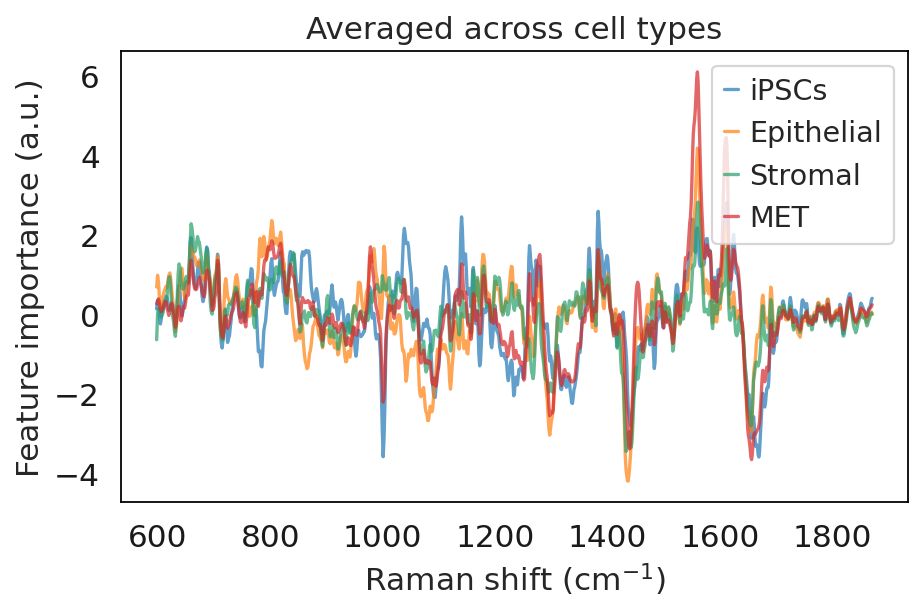

In [42]:
# for g,ax in zip(model.keys(), axs.flatten()):
ct_gs = {'iPSCs':['Pou5f1', 'Nanog', 'Utf1'], 'Epithelial':['Krt7', 'Peg10'], 'Stromal':['Bgn', 'Col1a1'], 'MET':['Nnat', 'Fabp7']}

plt.figure(figsize=(6,4.1))
# for ct in list(ct_gs.keys())[:2]:
# for ct in list(ct_gs.keys())[1:4:2]:
cts = list()
for ct in list(ct_gs.keys()):
    spec = np.zeros((len(ct_gs[ct]),930))
    for i,g in enumerate(ct_gs[ct]):
        feature_scores = model[g].get_feature_importance()
        spec[i,:] = np.dot(feature_scores, pca.components_)
    plt.plot(xaxis, np.mean(spec, axis=0), alpha=0.7)
    cts.append(ct)
plt.legend(cts, loc='upper right')
plt.title('Averaged across cell types')
plt.xlabel('Raman shift (cm$^{-1})$')
plt.ylabel('Feature importance (a.u.)')
plt.tight_layout()
plt.grid(None)
plt.savefig('figures/feature_importance_avg_celltypes.pdf')

***
# Leave-one-out cross-validation (LOOCV)

In [15]:
genes = ad_sp_pred.var_names
genes = [g.lower() for g in genes]

np.random.seed(2021)
ad_tr_g = {}

for g in genes:
    mask1 = ad_sc_bal.var_names == g
    mask2 = ad_sp_pred.var_names == g
    ad_sc_g, ad_sp_g = tg.pp_adatas(ad_sc_bal[:,~mask1], ad_sp_pred[:,~mask2])
    ad_map_g = tg.map_cells_to_space(adata_cells=ad_sc_g, adata_space=ad_sp_g, device='cuda:0', random_state=2021);
    print(g)

    ad_tr_g[g] = tg.project_genes(ad_map_g, ad_sc_bal)#, cluster_label='leiden_cell_type')

INFO:root:8 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 8 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.920
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000


INFO:root:Saving results..


nanog


INFO:root:8 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 8 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.901
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000


INFO:root:Saving results..


bgn


INFO:root:8 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 8 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.912
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000


INFO:root:Saving results..


col1a1


INFO:root:8 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 8 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.913
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000


INFO:root:Saving results..


krt7


INFO:root:8 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 8 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.924
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000


INFO:root:Saving results..


peg10


INFO:root:8 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 8 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.920
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000


INFO:root:Saving results..


utf1


INFO:root:8 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 8 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.903
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000


INFO:root:Saving results..


epcam


INFO:root:8 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 8 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.901
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000


INFO:root:Saving results..


nnat


INFO:root:8 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 8 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.905
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000


INFO:root:Saving results..


fabp7


In [16]:
np.random.seed(2021)
ad_trn_tr_g = {}

for g in genes:
    mask1 = ad_sc_bal.var_names == g
    mask2 = ad_sp_tr_pred.var_names == g
    ad_sc_g, ad_sp_tr_g = tg.pp_adatas(ad_sc_bal[:,~mask1], ad_sp_tr_pred[:,~mask2])
    ad_map_g = tg.map_cells_to_space(adata_cells=ad_sc_g, adata_space=ad_sp_tr_g, device='cuda:0', random_state=2021);
    print(g)

    ad_trn_tr_g[g] = tg.project_genes(ad_map_g, ad_sc_bal)#, cluster_label='leiden_cell_type')

INFO:root:8 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 8 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.909
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000


INFO:root:Saving results..


nanog


INFO:root:8 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 8 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.884
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000


INFO:root:Saving results..


bgn


INFO:root:8 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 8 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.902
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000


INFO:root:Saving results..


col1a1


INFO:root:8 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 8 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.897
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000


INFO:root:Saving results..


krt7


INFO:root:8 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 8 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.908
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000


INFO:root:Saving results..


peg10


INFO:root:8 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 8 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.907
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000


INFO:root:Saving results..


utf1


INFO:root:8 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 8 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.887
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000


INFO:root:Saving results..


epcam


INFO:root:8 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 8 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.885
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000


INFO:root:Saving results..


nnat


INFO:root:8 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 8 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.888
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000
Score: 1.000


INFO:root:Saving results..


fabp7


In [22]:
from scipy.stats import pearsonr
from sklearn.metrics.pairwise import cosine_similarity

print('cosine similarity')

trains = []
tests = []
for g in genes:
    # test cosine similarity
    x = (ad_tr_g[g][:,g].X.flatten())
    y = (Y_tst[g.capitalize()])
#     c = pearsonr(x,y)[0]
    c = cosine_similarity([x], [y])[0,0]
    tests.append(c)
    print(g)
    print('\ttest: '+str(round(c, 2)))#+' p: '+str(r[1]))
    
    # train
    x = ad_trn_tr_g[g][:,g].X.flatten()
    y = Y_trn[g.capitalize()].to_numpy()
#     c = pearsonr(x,y)[0]
    c = cosine_similarity([x], [y])[0,0]
    trains.append(c)
    print('\ttrain: '+str(round(c, 2)))#+' p: '+str(r[1]))

cosine similarity
nanog
	test: 0.79
	train: 0.83
bgn
	test: 0.89
	train: 0.86
col1a1
	test: 0.38
	train: 0.39
krt7
	test: 0.87
	train: 0.89
peg10
	test: 0.81
	train: 0.83
utf1
	test: 0.85
	train: 0.86
epcam
	test: 0.91
	train: 0.9
nnat
	test: 0.96
	train: 0.93
fabp7
	test: 0.83
	train: 0.79


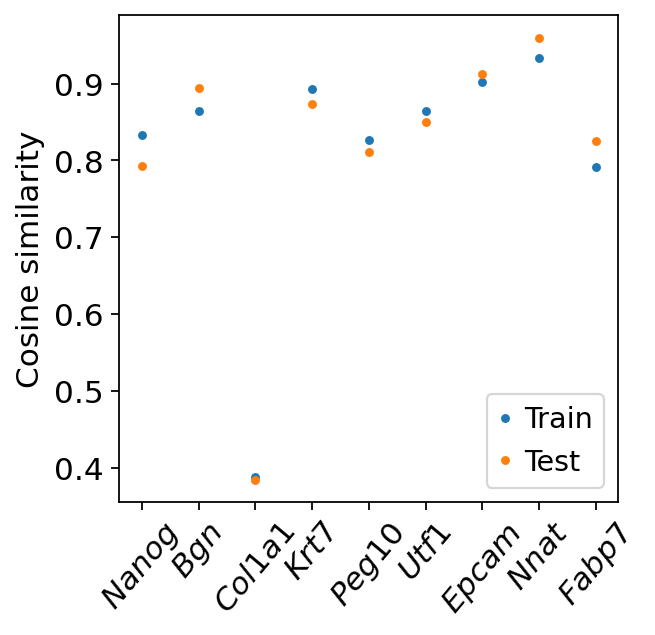

In [40]:
'''visualize test/train results'''
plt.grid(None)
plt.plot(np.array(trains), '.')
plt.plot(np.array(tests), '.')
plt.ylabel('Cosine similarity')
plt.xticks(ticks=range(len(genes)), labels=['$\it{'+g.capitalize()+'}$' for g in genes], rotation=50)
plt.legend(['Train', 'Test'], loc='lower right')
plt.savefig('figures/LOOCV_cosine_similarity.pdf')

***
# Map HCR and scRNAseq

In [39]:
'''predict scrnaseq from raman'''
ad_sp_hcr_sub = ad_sp_hcr[ad_sp_hcr.obs.sample(int(ad_sp_hcr.shape[0]/2)).index,:]
ad_sc_bal_pp, ad_sp_hcr_pp = tg.pp_adatas(ad_sc_bal, ad_sp_hcr_sub)
# ad_sc_bal_pp, ad_sp= tg.pp_adatas(ad_sc, ad_sp_pred)
ad_sc_bal_pp

np.random.seed(2021)
ad_map = tg.map_cells_to_space(
    adata_cells=ad_sc_bal_pp,
    adata_space=ad_sp_hcr_pp,
#     device='cpu',
    device='cuda:0',
    random_state=2021
)
ad_hcr_tr = tg.project_genes(ad_map, ad_sc_bal)#, cluster_label='leiden_cell_type')
# ad_tr = tg.project_genes(ad_map, ad_sc)#, cluster_label='leiden_cell_type')
ad_hcr_tr

INFO:root:9 marker genes shared by AnnDatas.
INFO:root:Allocate tensors for mapping.
INFO:root:Begin training with 9 genes in cells mode...
INFO:root:Printing scores every 100 epochs.


Score: 0.783
Score: 0.995
Score: 0.996
Score: 0.996
Score: 0.996
Score: 0.996
Score: 0.996
Score: 0.996
Score: 0.996
Score: 0.996


INFO:root:Saving results..


AnnData object with n_obs × n_vars = 6391 × 17737
    obs: 'image', 'day', 'pos', 'pix_x', 'pix_y', 'x', 'y'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'n_cells', 'is_training'

In [40]:
ad_hcr_tr_pp, ad_sc_pp = tg.pp_adatas(ad_hcr_tr, ad_sc)
sc.pp.log1p(ad_hcr_tr_pp)
sc.pp.log1p(ad_sc_pp)

filtered out 128 genes that are detected in less than 1 cells


INFO:root:17737 marker genes shared by AnnDatas.


In [41]:
# sc.pp.subsample(ad_sc_pp, fraction=0.1)
sc.pp.pca(ad_sc_pp)
sc.pp.neighbors(ad_sc_pp, metric='cosine')
sc.tl.umap(ad_sc_pp)

# ad_sc_pp.obs['predicted_id'] = ad_sc_pp.obs['leiden_cell_type']
sc.tl.ingest(ad_hcr_tr_pp, ad_sc_pp, embedding_method='umap', labeling_method='knn')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:06)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:16)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:43)
running ingest
    finished (0:00:21)


In [42]:
gs = ['nanog','utf1', 'krt7','peg10', 'col1a1','bgn','epcam','fabp7','nnat']

for g in gs:
    ad_sc_pp.obs['ref_'+g] = np.nan
    ad_hcr_tr_pp.obs['ref_'+g] = ad_hcr_tr_pp[:,g].X
    
    ad_sc_pp.obs['rna_'+g] = ad_sc_pp[:,g].X.toarray()
    ad_hcr_tr_pp.obs['rna_'+g] = np.nan
    
#     ad_tr_log.obs['batch'] = np.nan
ad_hcr_tr_pp.obs['batch'] = 'smFISH scRNA-seq'
ad_hcr_tr_pp.obs['batch'] = ad_hcr_tr_pp.obs['batch'].astype('category') 
#     ad_sc_log.obs['batch'] = np.nan
ad_sc_pp.obs['batch'] = 'Ref scRNA-seq'
ad_sc_pp.obs['batch'] = ad_sc_pp.obs['batch'].astype('category')
ad_sc_pp_sub = sc.pp.subsample(ad_sc_pp, fraction=0.5, copy=True)

ad_sc_hcr_tr = sc.AnnData.concatenate(ad_sc_pp_sub, ad_hcr_tr_pp, join='inner')
df = ad_sc_hcr_tr.obs['batch']
df = df.replace(to_replace='0', value='Ref scRNA-seq')
df = df.replace(to_replace='1', value='smFISH scRNA-seq')
ad_sc_hcr_tr.obs['batch']=df

ad_sc_hcr_tr.obs.head(2)

,cell_type,day,leiden,leiden_cell_type,ref_nanog,rna_nanog,ref_utf1,rna_utf1,ref_krt7,rna_krt7,...,rna_fabp7,ref_nnat,rna_nnat,batch,image,pos,pix_x,pix_y,x,y
D13_serum_C1_CGTAGCGCATGCTGGC-1-0,Stromal,13.0,1,Stromal,NaN,0.0,NaN,0.0,NaN,0.0,...,0.0,NaN,0.0,Ref scRNA-seq,NaN,NaN,NaN,NaN,NaN,NaN
D13_serum_C1_CGAGAAGGTAATCACC-1-0,Stromal,13.0,1,Stromal,NaN,0.0,NaN,0.0,NaN,0.0,...,0.0,NaN,0.0,Ref scRNA-seq,NaN,NaN,NaN,NaN,NaN,NaN


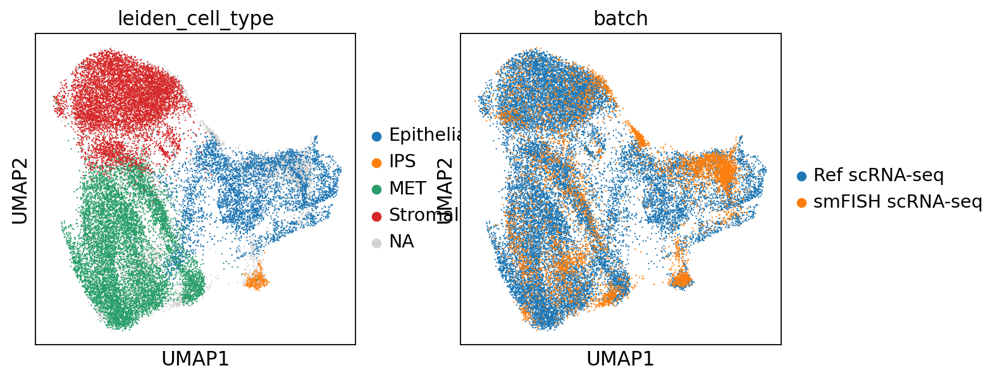

In [43]:
sc.pl.umap(ad_sc_hcr_tr, color=['leiden_cell_type', 'batch'], 
           ncols=2, save='_coembed_tangram_scrnaseq_smfish.pdf')


## Density UMAP plot

In [44]:
sc.tl.embedding_density(ad_sc_hcr_tr, groupby='batch')

computing density on 'umap'
--> added
    'umap_density_batch', densities (adata.obs)
    'umap_density_batch_params', parameter (adata.uns)


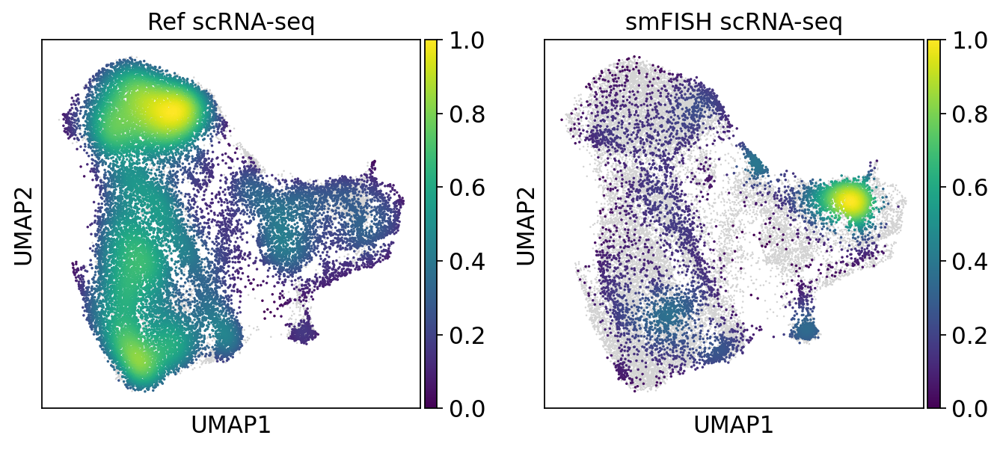

In [45]:
sc.pl.embedding_density(ad_sc_hcr_tr, basis='umap', key='umap_density_batch', bg_dotsize=5, fg_dotsize=10,
                       color_map='viridis', save='coembed_density_smFISH.pdf')

## UMAP gene scores

In [ ]:
sc.pp.log1p(ad_sc_hcr_tr)
gs = ['nanog','utf1','krt7','peg10','bgn','col1a1','nnat','fabp7']
Gs = [g.capitalize() for g in gs]

ad_sc_tr_hcr = ad_sc_hcr_tr.copy()
indices = [idx+'-1' for idx in ad_sp_hcr_sub.obs_names]
ad_sc_tr_hcr[indices, gs].X = ad_sp_hcr_sub[:,Gs].X

sc.tl.score_genes(ad_sc_tr_hcr, ['nanog', 'utf1'], score_name='iPSCs_score')
sc.tl.score_genes(ad_sc_tr_hcr, ['krt7', 'peg10'], score_name='Epithelial_score')
sc.tl.score_genes(ad_sc_tr_hcr, ['bgn', 'col1a1'], score_name='Stromal_score')
sc.tl.score_genes(ad_sc_tr_hcr, ['nnat', 'fabp7'], score_name='MET_score')

for score in ['iPSCs_score', 'Epithelial_score', 'Stromal_score', 'MET_score']:
    ad_sc_tr_hcr.obs.loc[:,score+'_raman'] = ad_sc_tr_hcr.obs.loc[:,score]

mask = ad_sc_tr_hcr.obs.batch == 'Ref scRNA-seq'
ad_sc_tr_hcr.obs.loc[mask,'iPSCs_score_smFISH':'MET_score_smFISH'] = np.nan

mask = ad_sc_tr_hcr.obs.batch == 'smFISH scRNA-seq'
ad_sc_tr_hcr.obs.loc[mask,'iPSCs_score':'MET_score'] = np.nan

In [ ]:
sc.pl.umap(ad_sc_tr_hcr, color=['iPSCs_score_raman', 'Epithelial_score_raman', 'Stromal_score_raman', 'MET_score_raman'], 
           vmin='p5', vmax='p95', save='_tangram_smfishscores.pdf', title=['iPSCs Raman gene scores', 'Epithelial Raman gene scores', 'Stromal Raman gene scores', 'MET Raman gene scores'], color_map='viridis',
           ncols=2
          )

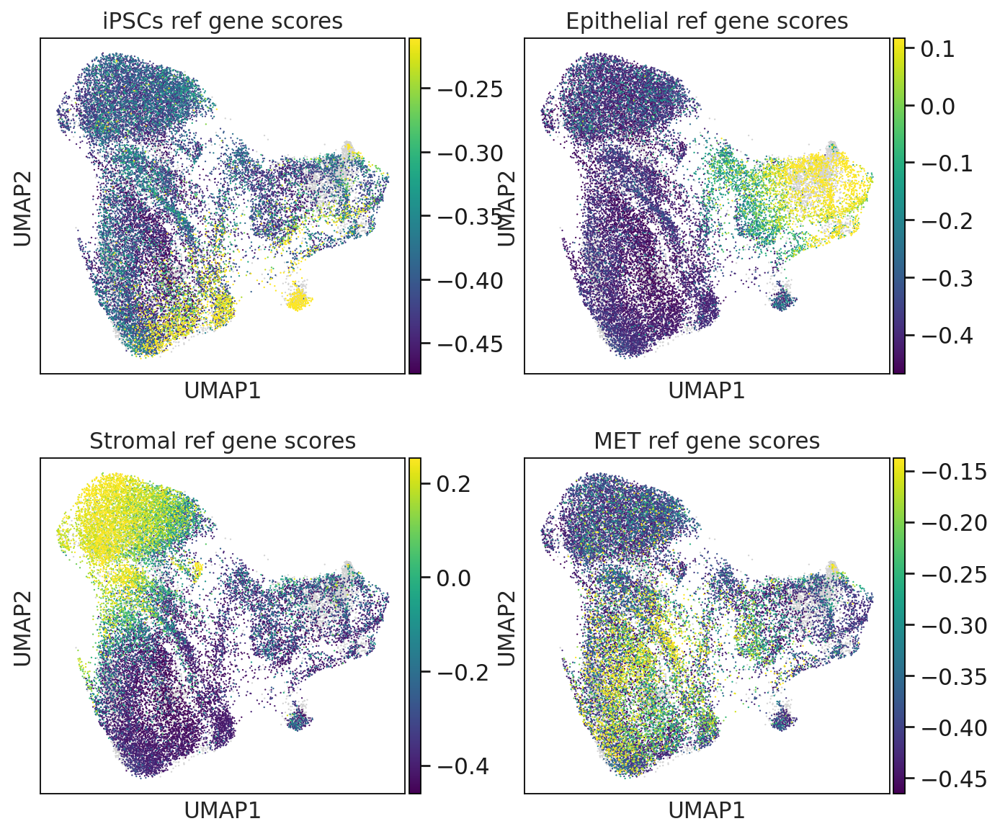

In [43]:
sc.pl.umap(ad_sc_tr_hcr, color=['iPSCs_score', 'Epithelial_score', 'Stromal_score', 'MET_score'], 
           vmin='p5', vmax='p95', save='_tangram_scores.pdf', title=['iPSCs ref gene scores', 'Epithelial ref gene scores', 'Stromal ref gene scores', 'MET ref gene scores'], color_map='viridis',
          ncols=2)

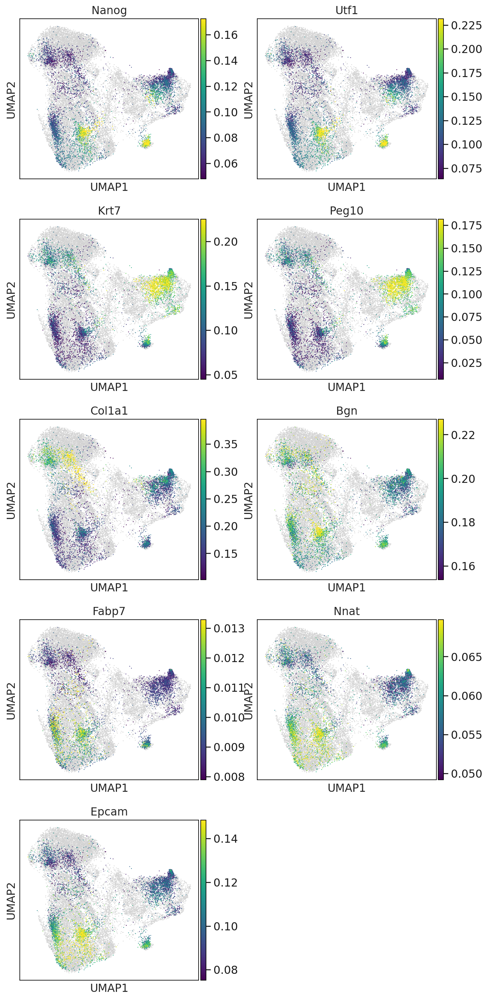

In [44]:
gs = ['nanog', 'utf1', 'krt7', 'peg10', 'col1a1', 'bgn', 'fabp7', 'nnat', 'epcam']
sc.pl.umap(ad_sc_tr_hcr, color=['ref_'+g for g in gs], vmin='p5', vmax='p95', save='_tangram_ramangenes.pdf', ncols=2,
          title=[g.capitalize() for g in gs], color_map='viridis')

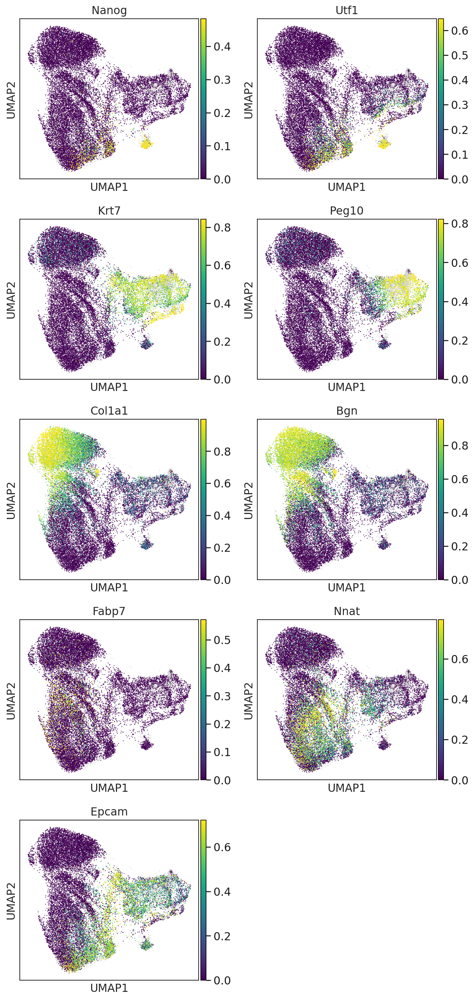

In [45]:
gs = ['nanog', 'utf1', 'krt7', 'peg10', 'col1a1', 'bgn', 'fabp7', 'nnat', 'epcam']
sc.pl.umap(ad_sc_tr_hcr, color=['rna_'+g for g in gs], vmin='p2', vmax='p98', save='_tangram_genes.pdf', ncols=2,
          title=[g.capitalize() for g in gs], color_map='viridis')